# Inference 

In [1]:
import os
os.environ["OPENCV_IO_MAX_IMAGE_PIXELS"] = pow(2,40).__str__()

In [2]:
!set CV_IO_MAX_IMAGE_PIXELS=18500000000

In [3]:
import os 
from mmdet.apis import init_detector, show_result_pyplot
from mmrotate.apis import inference_detector_by_patches
import mmrotate
import torch
print(mmrotate)
mmrotate.__version__=='0.3.4'

/mnt/hdd/eric/.conda/envs/8.tmp/lib/python3.8/site-packages/mmcv/__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(


<module 'mmrotate' from '/mnt/hdd/eric/.tmp_ipy/00.Reproduction_Test/mmrotate/__init__.py'>


True

In [4]:
checkpoint_file = "/mnt/hdd/eric/.tmp_ipy/00.Checkpoint/ship_tmp_multi_13_roi_trans/epoch_40.pth"
config_file = "/mnt/hdd/eric/.tmp_ipy/00.Checkpoint/ship_tmp_multi_13_roi_trans/ship_fine_tunning.py"


In [5]:
from mmcv import Config

cfg = Config.fromfile(config_file)

In [6]:
#--------------------------------------
#----- classes
cfg.model.roi_head.bbox_head[0].num_classes=13 
cfg.model.roi_head.bbox_head[1].num_classes=13


classes=(
        'Barge', 'Cargo', 'Container_Ship', 'Dock', 'Fishing_Vessel',
        'Hovercraft', 'Motorboat', 'Oil_Tanker', 'Other_Aircraft_Carrier',
        'RoRo', 'Submarine', 'Warship', 'Yacht'
    )
cfg.data.train.classes=classes
cfg.data.val.classes=classes
cfg.data.test.classes=classes

# batch 
cfg.data.samples_per_gpu = 1

cfg.gpu_ids = [0]
cfg.device='cuda'
cfg.seed=22

# random seed
from mmdet.apis import set_random_seed
set_random_seed(cfg.seed,deterministic=True)

In [7]:
model = init_detector(cfg, checkpoint_file, device='cuda:0')

/mnt/hdd/eric/.conda/envs/8.tmp/lib/python3.8/site-packages/mmdet/models/dense_heads/anchor_head.py:116: UserWarning: DeprecationWarning: `num_anchors` is deprecated, for consistency or also use `num_base_priors` instead
  warnings.warn('DeprecationWarning: `num_anchors` is deprecated, '


load checkpoint from local path: /mnt/hdd/eric/.tmp_ipy/00.Checkpoint/ship_tmp_multi_13_roi_trans/epoch_40.pth
model to device #-----------------------------# :  cuda:0


KeyboardInterrupt: 

In [ ]:
import cv2
from PIL import Image
import matplotlib.pyplot as plt

sample_img = "/mnt/hdd/eric/.tmp_ipy/00.Data/AO/0-Pusan-2023-AO/C1_20221227015155_09806_00006119_L1G/0-Pusan-2023-AO_1_C1_20221227015155_09806_00006119_L1G.png"
img_ = Image.open(sample_img)

#plt.figure(figsize=(80,80))
#plt.imshow(img_)

print(img_.size)

(7410, 7220)


In [ ]:
#--------------------------------

from easydict import EasyDict
import numpy as np
 
args = EasyDict()
args.img = "/mnt/hdd/eric/.tmp_ipy/00.Data/AO/0-Pusan-2023-AO/C1_20221227015155_09806_00006119_L1G/0-Pusan-2023-AO_1_C1_20221227015155_09806_00006119_L1G.png"
args.patch_sizes = [1024,800,2048]
args.patch_steps = [824,672,1920]
args.img_ratios = [1.0,1.5,2.0]

args.merge_iou_thr = 0.1
args.device = 'cuda:0'
args.score_thr = 0.2
args.palette = 'dota'

infer_flag = False
if infer_flag:
    result = inference_detector_by_patches(model, args.img, args.patch_sizes,
                                            args.patch_steps, args.img_ratios,
                                            args.merge_iou_thr)
result = np.load("/mnt/hdd/eric/.tmp_ipy/00.Data/tmp_/roi_trans_multilabel-epoch-40_mergeiou-0.1_scroethr-0.2_0119.npy",allow_pickle=True)

# show the results
# show_result_pyplot(
#     model,
#     args.img,
#     result,
#     palette=args.palette,
#     score_thr=args.score_thr,
#     out_file=os.path.join("/mnt/hdd/eric/.tmp_ipy/00.Data/tmp_", "roi_trans_multilabel-epoch-40_mergeiou-0.1_scroethr-0.2_0119.png") )


In [ ]:
# # result save 
# import numpy as np
# np.save("/mnt/hdd/eric/.tmp_ipy/00.Data/tmp_/roi_trans_multilabel-epoch-40_mergeiou-0.1_scroethr-0.2_0119.npy", result)

In [ ]:
# Check the number of classes
# - show result pyplot 으로 나오는 result 결과가, class 별로 나오는 듯하다. 해당 부분을 확인해줄 필요가 있다. 

result.__len__()

13

In [ ]:
result[0][-1][-1]

0.060876243

In [ ]:
result[0]

array([[3.2932e+03, 8.1207e+02, 1.0899e+02, 2.3987e+01, 1.3563e+00, 6.0876e-02]], dtype=float32)

In [ ]:
# box 마다,class 값들을 부여해주기
total_boxes = []
for i,clsses in enumerate(result):
    tmp_boxes = []
    for box in clsses:
        print("box ", box)
        new_box = np.append(box,int(i))
        print("new box" , new_box) 
        tmp_boxes.append(new_box)
        
    
    total_boxes.append(tmp_boxes)

box  [3.2932e+03 8.1207e+02 1.0899e+02 2.3987e+01 1.3563e+00 6.0876e-02]
new box [3.2932e+03 8.1207e+02 1.0899e+02 2.3987e+01 1.3563e+00 6.0876e-02 0.0000e+00]
box  [ 6.0610e+03  2.5795e+03  1.0016e+02  2.1683e+01 -9.5683e-01  9.7984e-01]
new box [ 6.0610e+03  2.5795e+03  1.0016e+02  2.1683e+01 -9.5683e-01  9.7984e-01  1.0000e+00]
box  [ 5.1189e+03  1.0238e+03  6.1411e+01  1.3473e+01 -6.4601e-01  9.7629e-01]
new box [ 5.1189e+03  1.0238e+03  6.1411e+01  1.3473e+01 -6.4601e-01  9.7629e-01  1.0000e+00]
box  [ 5.1115e+03  7.3898e+02  5.8019e+01  1.3329e+01 -4.2553e-01  9.6093e-01]
new box [ 5.1115e+03  7.3898e+02  5.8019e+01  1.3329e+01 -4.2553e-01  9.6093e-01  1.0000e+00]
box  [5.5169e+03 1.8524e+02 5.2787e+01 1.1451e+01 1.6309e-01 9.5625e-01]
new box [5.5169e+03 1.8524e+02 5.2787e+01 1.1451e+01 1.6309e-01 9.5625e-01 1.0000e+00]
box  [ 5.4513e+03  2.7095e+03  1.1750e+02  1.7515e+01 -1.3537e+00  9.5202e-01]
new box [ 5.4513e+03  2.7095e+03  1.1750e+02  1.7515e+01 -1.3537e+00  9.5202e-01  

In [ ]:
# Check the boxes
for cate in total_boxes:
    for box in cate:
        print(box[-1])

0.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
2.0
2.0
2.0
2.0
2.0
2.0
2.0
2.0
2.0
2.0
2.0
2.0
2.0
3.0
3.0
3.0
3.0
3.0
4.0
4.0
5.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
6.0
7.0
7.0
7.0
7.0
7.0
7.0
7.0
7.0
7.0
7.0
7.0
7.0
7.0
7.0
8.0
8.0
9.0
9.0
9.0
9.0
9.0
9.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
10.0
11.0
11.0
11.0
11.0
11.0
11.0
11.0
11.

In [ ]:
total_boxes

[[array([3.2932e+03, 8.1207e+02, 1.0899e+02, 2.3987e+01, 1.3563e+00, 6.0876e-02, 0.0000e+00])],
 [array([ 6.0610e+03,  2.5795e+03,  1.0016e+02,  2.1683e+01, -9.5683e-01,  9.7984e-01,  1.0000e+00]),
  array([ 5.1189e+03,  1.0238e+03,  6.1411e+01,  1.3473e+01, -6.4601e-01,  9.7629e-01,  1.0000e+00]),
  array([ 5.1115e+03,  7.3898e+02,  5.8019e+01,  1.3329e+01, -4.2553e-01,  9.6093e-01,  1.0000e+00]),
  array([5.5169e+03, 1.8524e+02, 5.2787e+01, 1.1451e+01, 1.6309e-01, 9.5625e-01, 1.0000e+00]),
  array([ 5.4513e+03,  2.7095e+03,  1.1750e+02,  1.7515e+01, -1.3537e+00,  9.5202e-01,  1.0000e+00]),
  array([5.4244e+03, 4.7485e+02, 7.8842e+01, 1.0732e+01, 1.3658e-01, 9.3864e-01, 1.0000e+00]),
  array([6.6367e+03, 2.6700e+03, 1.0078e+02, 1.9379e+01, 7.3553e-01, 9.3764e-01, 1.0000e+00]),
  array([5.9270e+03, 5.2698e+02, 6.2407e+01, 1.1320e+01, 1.4598e-01, 9.3588e-01, 1.0000e+00]),
  array([5.6897e+03, 7.5154e+02, 5.3948e+01, 1.1085e+01, 6.1306e-02, 9.2387e-01, 1.0000e+00]),
  array([ 5.6816e+03,

# Visual

In [ ]:
# box rotate visual
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Polygon
import math

# Example usage:
box = [100, 200, 80, 40]

def convert_to_polygon(box):
    x, y, width, height = box

    # Calculate the coordinates of the four corners # => 이거 좌하단 기준인데.. ? 
    # => center 기준으로 update
    x1, y1 = x - (0.5 * width) , y - (0.5 * height)
    x2, y2 = x + (0.5 * width),  y - (0.5 * height)
    x3, y3 = x + (0.5 * width),  y + (0.5 * height)
    x4, y4 = x - (0.5 * width),  y + (0.5 * height)

    # Create a list of points representing the polygon
    polygon = [[x1, y1], [x2, y2],[x3, y3], [x4, y4]]

    return polygon

polygon = convert_to_polygon(box)
print("Polygon:", polygon)

Polygon: [[60.0, 180.0], [140.0, 180.0], [140.0, 220.0], [60.0, 220.0]]


In [ ]:
Polygons =  [ [(100, 200), (180, 200), (180, 240), (100, 240)], [(100, 200), (180, 200), (180, 240), (100, 240)] ] 

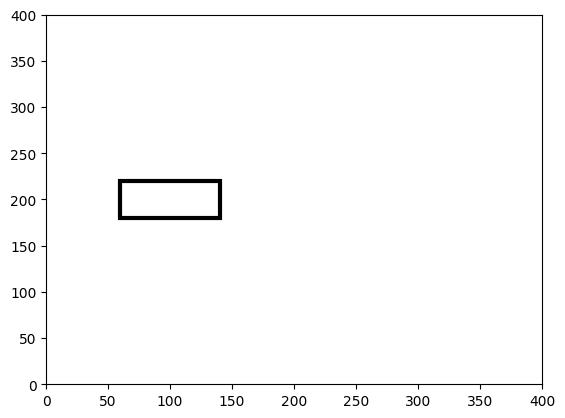

In [ ]:
def draw_polygon(polygon):
    y = np.array(polygon)
    p = Polygon(y, facecolor = 'k',fill= None, lw=3)

    fig,ax = plt.subplots()

    ax.add_patch(p)
    ax.set_xlim([0,400])
    ax.set_ylim([0,400])
    plt.show()

#--- draw_poly
draw_polygon(polygon)

In [ ]:
# rotate box 

def rotate_point(point, center, angle_degrees):
    angle_radians = np.radians(angle_degrees)
    x, y = point
    cx, cy = center

    new_x = (x - cx) * np.cos(angle_radians) - (y - cy) * np.sin(angle_radians) + cx
    new_y = (x - cx) * np.sin(angle_radians) + (y - cy) * np.cos(angle_radians) + cy

    return [new_x, new_y]

def rotate_bounding_box(box, center, angle_degrees):
    rotated_box = [rotate_point(point, center, angle_degrees) for point in box]
    return rotated_box

def get_ceter_bounding_box(box):
    polygon= box
    width_center =max( [ i[0] for i in polygon] ) - min( [ i[0] for i in polygon] ) 
    height_center = max( [ i[1] for i in polygon] ) - min( [ i[1] for i in polygon] )
    x_center = min( [ i[0] for i in polygon] )  + 1/2* width_center
    y_center = min( [ i[1] for i in polygon] )  + 1/2* height_center

    return [x_center, y_center]

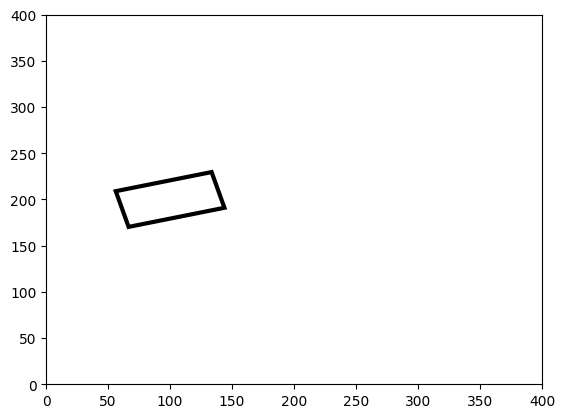

[[66.53934785048767, 170.3287216701178], [143.81341395361315, 191.03424527831947], [133.46065214951233, 229.6712783298822], [56.18658604638684, 208.96575472168053]]


In [ ]:
# Original bounding box
original_box = polygon

# Rotation center (you can change this to rotate around a different point)
rotation_center = get_ceter_bounding_box(original_box)

# Rotation angle in degrees
rotation_angle = 15

# Rotate the bounding box
rotated_box = rotate_bounding_box(original_box, rotation_center, rotation_angle)
rotated_polygon = [(rotated_box[0]),(rotated_box[1]),(rotated_box[2]),(rotated_box[3])]

#---- draw
draw_polygon(rotated_polygon)
print(rotated_polygon)

In [ ]:
[[101.89532693128334, 196.58987632825875], [181.590902778623, 203.5623357480714], [178.10467306871666, 243.41012367174125], [98.40909722137701, 236.4376642519286]]
[[104.08065343285028, 193.35791783307863], [182.86527367382692, 207.24977204643307], [175.91934656714972, 246.64208216692137], [97.13472632617308, 232.75022795356693]]
[[106.53934785048767, 190.3287216701178], [183.81341395361315, 211.03424527831947], [173.46065214951233, 249.6712783298822], [96.18658604638685, 228.96575472168053]]


[[106.53934785048767, 190.3287216701178],
 [183.81341395361315, 211.03424527831947],
 [173.46065214951233, 249.6712783298822],
 [96.18658604638685, 228.96575472168053]]

# Calculate IOU

In [ ]:
from shapely.geometry import Polygon as PolygonShapley

# Convert the given coordinates into Shapely Polygon objects
polygon1 = PolygonShapley([[100, 200], [180, 200], [180, 240], [100, 240]])
# polygon2 = PolygonShapley([
#     [250,250],
#     [350,250],
#     [350,350],
#     [250,350]
# ])
polygon2 = PolygonShapley(rotated_polygon)

# Calculate the intersection area
intersection_area = polygon1.intersection(polygon2).area

# Calculate the area of each polygon
area_polygon1 = polygon1.area
area_polygon2 = polygon2.area

# Calculate the IoU
iou = intersection_area / (area_polygon1 + area_polygon2 - intersection_area)

print("Intersection over Union (IoU):", iou)

Intersection over Union (IoU): 0.17663702948224894


# Polygon with Confidence and Class

In [ ]:
# polygon with Confidence and class !
import nms

sample_polygons = [ [ [100, 200], [180, 200], [180, 240], [100, 240] ], 
                   
                   [[115.35898384862246, 182.67949192431124],
 [184.64101615137753, 222.67949192431124],
 [164.64101615137753, 257.32050807568874],
 [95.35898384862246, 217.32050807568876] ]]

scores = [0.9,0.8]


In [ ]:
sample_polygons[0]

[[100, 200], [180, 200], [180, 240], [100, 240]]

In [ ]:
import nms

import nms.fast as fast
import nms.felzenszwalb as felzenszwalb
import nms.malisiewicz as malisiewicz

In [ ]:
len(sample_polygons)

2

In [ ]:
sample_polygons = [[[101.89532693128334, 196.58987632825875], [181.590902778623, 203.5623357480714], [178.10467306871666, 243.41012367174125], [98.40909722137701, 236.4376642519286]],
[[104.08065343285028, 193.35791783307863], [182.86527367382692, 207.24977204643307], [175.91934656714972, 246.64208216692137], [97.13472632617308, 232.75022795356693]],
[[106.53934785048767, 190.3287216701178], [183.81341395361315, 211.03424527831947], [173.46065214951233, 249.6712783298822], [96.18658604638685, 228.96575472168053]],

[[206,290],[283,311],[273,349],[196,328]]
]

scores = [0.3,0.5,0.4,0.9]

In [ ]:
len(scores)

4

In [ ]:
total_boxes.__len__()

13

In [ ]:
# total box to polygon ! 

In [ ]:
[i for i in total_boxes[0][0]]

[3293.2392578125,
 812.0725708007812,
 108.98882293701172,
 23.986515045166016,
 1.3563448190689087,
 0.06087624281644821,
 0.0]

In [ ]:
# total_boxes
# [center_x, center_y, width, height, angle, prob, class]

# 0. center_format(x,y,w,h,a) 
# 1. draw box without angle (x,y,w,h) to polyformat [[x1,y1],[x2,y2],[x3,y3],[x4,y4]]
#    => matplotlib 에서는, 좌하단을 포인트로 잡는데, model output은 center 좌표임을 명시! 
# 2. rotate vertices 
# 3. convert to poly format 

# poly_format[[x1,y1],[x2,y2],[x3,y3],[x4,y4]]

In [ ]:
center_format_a = [i for i in total_boxes[0][0]][0:4]
print(center_format_a)
poly_format_a = convert_to_polygon(center_format_a)
print(poly_format_a)


[3293.2392578125, 812.0725708007812, 108.98882293701172, 23.986515045166016]
[[3238.744846343994, 800.0793132781982], [3347.733669281006, 800.0793132781982], [3347.733669281006, 824.0658283233643], [3238.744846343994, 824.0658283233643]]


In [ ]:
# each box convert to polygon
# box_cate = total_boxes[1]

'''
box sample

[polygon(vertices), prob_score] 

[[3293.360749780455, 756.2741447745613],
 [3316.5548281857787, 862.7663898073475],
 [3293.117765844545, 867.8709968270012],
 [3269.9236874392213, 761.378751794215],
 0.06087624281644821]
'''

all_rotated_poly_boxes = []
for box_cate in total_boxes:
    cate_boxes = []
    for box in box_cate:
        # rotate box
        
        # 1. draw box without angle  
        # convert 4type box to polygon 
        tmp_box = [box[0],box[1],box[2],box[3]]
        # poloy box 
        box_poly = convert_to_polygon(tmp_box)
        # angle
        tmp_angle = box[4]
        #print(tmp_angle)
        tmp_angle = tmp_angle*180/np.pi
        #print(tmp_angle)
        tmp_score = box[5]
        tmp_class = box[6]

        # center 
        tmp_center = [box[0],box[1]]
        # rotated_box
        rotated_box_poly = []
        
        # 2. rotate vertices 
        # 3. convert to polyformat 
        for vertice in box_poly:
            rotated_point = rotate_point(vertice, tmp_center, tmp_angle)
            #print(rotated_point)
            rotated_box_poly.append(rotated_point)

        # add score 
        rotated_box_poly.append(tmp_score)
        rotated_box_poly.append(tmp_class)

        # 4. 전체 박스를 하나의 리스트에 담기 위해서. 중간 box 거치지 않고 하나로 
        #cate_boxes.append(rotated_box_poly)
        all_rotated_poly_boxes.append(rotated_box_poly)

    #all_rotated_poly_boxes.append(cate_boxes)
    

In [ ]:
all_rotated_poly_boxes

[[[3293.360749780455, 756.2741447745613],
  [3316.5548281857787, 862.7663898073475],
  [3293.117765844545, 867.8709968270012],
  [3269.9236874392213, 761.378751794215],
  0.06087624281644821,
  0.0],
 [[6023.280747493606, 2614.222926836187],
  [6080.984665996332, 2532.3542250387864],
  [6098.707533756394, 2544.845920820063],
  [6041.003615253668, 2626.7146226174636],
  0.9798448085784912,
  1.0],
 [[5090.3228863024715, 1036.9336804494537],
  [5139.359225955957, 999.9637294484495],
  [5147.4700824475285, 1010.7218371286714],
  [5098.433742794043, 1047.6917881296754],
  0.9762903451919556,
  1.0],
 [[5082.361053197359, 744.8892271504919],
  [5135.206116525004, 720.9385170164433],
  [5140.708282740141, 733.0785462870081],
  [5087.863219412496, 757.0292564210567],
  0.9609342217445374,
  1.0],
 [[5491.752914150507, 175.30056044916407],
  [5543.839863112542, 183.8716808351739],
  [5541.980484286993, 195.17118027349218],
  [5489.893535324958, 186.60005988748236],
  0.9562534093856812,
  1.0]

In [ ]:
save_ = all_rotated_poly_boxes 
np.save("/mnt/hdd/eric/.tmp_ipy/00.Data/tmp_/rotated_box_poly_1.npy",save_)

In [ ]:
all_rotated_poly_boxes[0]

[[3293.360749780455, 756.2741447745613],
 [3316.5548281857787, 862.7663898073475],
 [3293.117765844545, 867.8709968270012],
 [3269.9236874392213, 761.378751794215],
 0.06087624281644821,
 0.0]

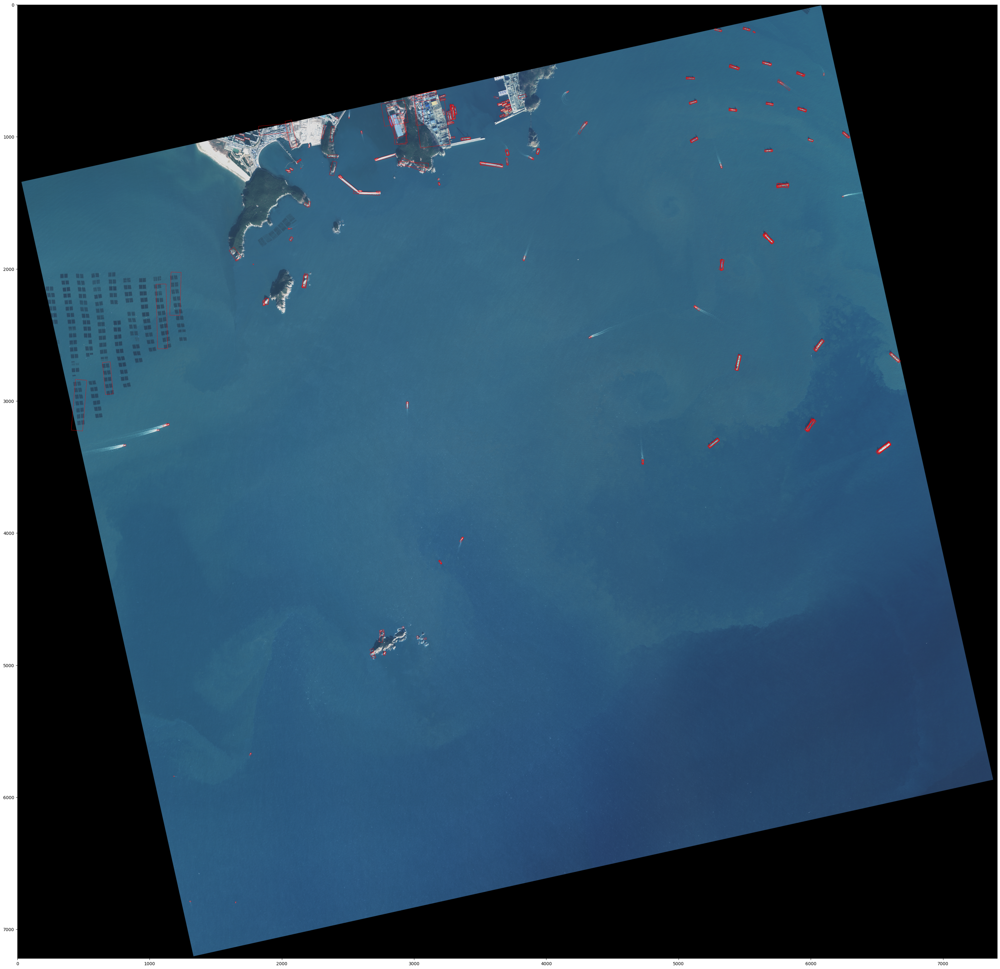

In [ ]:
# draw all rotated polygon to the image (before NMS)

# img var 
img_

# Create a figure and axes
fig, ax = plt.subplots(figsize=(40,40))

# Display the image
ax.imshow(img_)

# Draw each polygon on the image
for polygon_coords in all_rotated_poly_boxes:
    polygon_coords = polygon_coords[0:4]
    polygon = Polygon(polygon_coords, closed=True, edgecolor='r', linewidth=0.5, facecolor='none')
    ax.add_patch(polygon)

# Show the plot
plt.show()

In [ ]:
'''
nms_threshold : 0.2~0.8 
--> nms_threshold 이상의 iou 값들을 가진 box들은 다 지운다. 

score_threshold : 0.1~0.9
--> 각 박스들의 confidence score 를 threshold 이하의 박스들은 지운다. 
'''

nms_threshold_ = 0.3
score_threshold_ = 0.5


#--- score filtering 
# lib 에서 이 기능 고장난것으로 확인 -> 중간 알고리즘으로 추가 
lib_boxes = []
lib_scores = []
for box in all_rotated_poly_boxes:
    
    if box[4] > score_threshold_ :
        
        lib_boxes.append([ box[0:4]])
        lib_scores.append(box[4])

print(" confidence filtered boxes : ", len(lib_boxes), "total boxes : ", len(all_rotated_poly_boxes))


#--- NMS algorithm 
nms_result = felzenszwalb.nms(lib_boxes, lib_scores, nms_threshold=nms_threshold_,score_threshold=score_threshold_, top_k=len(lib_boxes), compare_function="poly_compare",area_function = "poly_areas" )

# indexing all boxes
nms_result_boxes = [all_rotated_poly_boxes[i] for i in nms_result]
print(" nms filtered boxes : ", nms_result.__len__())

 confidence filtered boxes :  118 total boxes :  339
area function edited by eric
start score filtering
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpeted
score accpe

 nms filtered boxes :  77


In [ ]:
[lib_scores[i] for i in nms_result]

[0.9973142743110657,
 0.9921028017997742,
 0.9915481209754944,
 0.9850014448165894,
 0.9842074513435364,
 0.9824768900871277,
 0.98020339012146,
 0.9798448085784912,
 0.9776045680046082,
 0.9762903451919556,
 0.9739320278167725,
 0.9725666642189026,
 0.9720596075057983,
 0.9709519147872925,
 0.9667263031005859,
 0.9645552635192871,
 0.9621831178665161,
 0.9609342217445374,
 0.9575859308242798,
 0.9562534093856812,
 0.9520161151885986,
 0.9500852823257446,
 0.949567973613739,
 0.9400967955589294,
 0.9386419057846069,
 0.9376407861709595,
 0.9358816742897034,
 0.9238734245300293,
 0.9231757521629333,
 0.9179925918579102,
 0.9173449873924255,
 0.9150730967521667,
 0.9148778319358826,
 0.9086535573005676,
 0.908411979675293,
 0.9059853553771973,
 0.9034545421600342,
 0.9005058407783508,
 0.893333911895752,
 0.8919527530670166,
 0.8863689303398132,
 0.88630610704422,
 0.8856853246688843,
 0.8489829897880554,
 0.8471169471740723,
 0.8456828594207764,
 0.8414352536201477,
 0.8343092203140259,

In [ ]:
print(" from all rotated boxes : " , all_rotated_poly_boxes.__len__() )
print(" selected boxes after NMS : ", nms_result.__len__())

 from all rotated boxes :  339
 selected boxes after NMS :  77


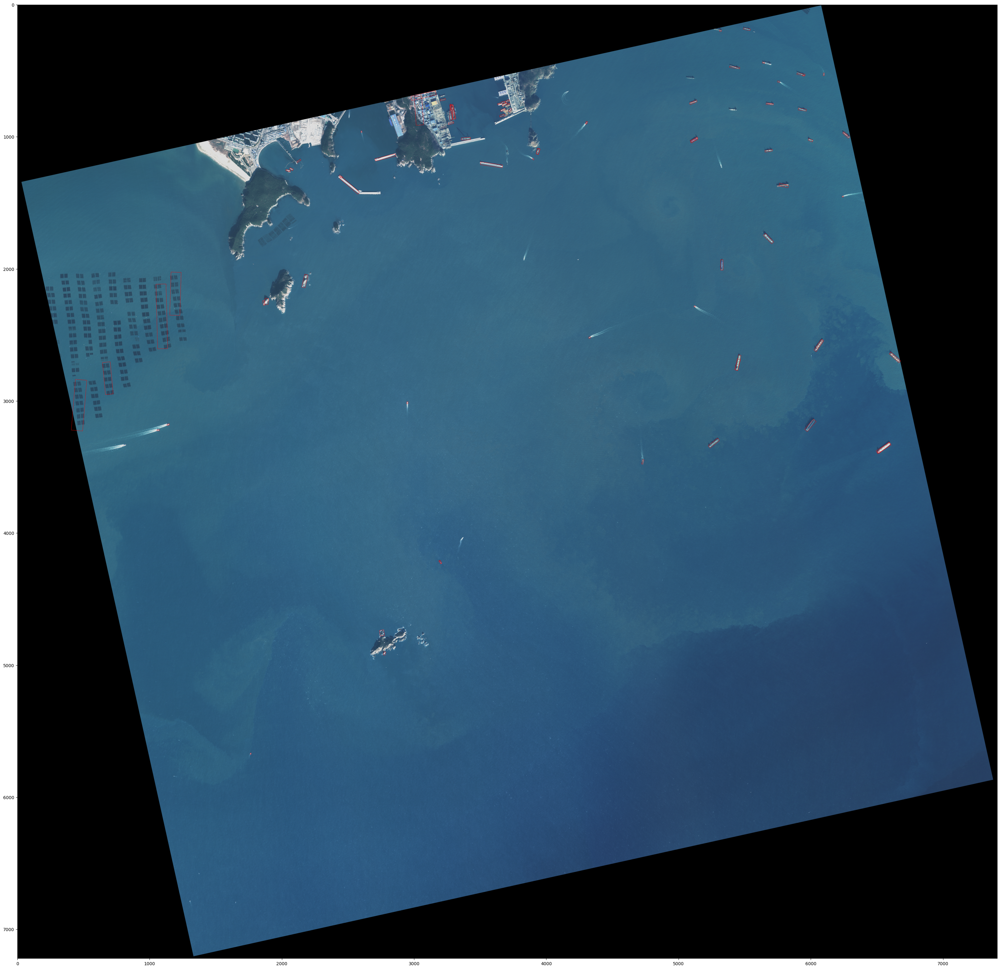

In [ ]:
# Draw NMS boxes ! 

# img var 
img_
# Create a figure and axes
fig, ax = plt.subplots(figsize=(40,40))
# Display the image
ax.imshow(img_)

# Draw each polygon on the image
for polygon_coords in nms_result_boxes:
    polygon_coords = polygon_coords[0:4]
    polygon = Polygon(polygon_coords, closed=True, edgecolor='r', linewidth=0.5, facecolor='none')
    ax.add_patch(polygon)

# Show the plot
plt.show()

# NMS Implementation

In [ ]:
test_boxes = all_rotated_poly_boxes[0:4]

In [ ]:
test_boxes

[[[3293.360749780455, 756.2741447745613],
  [3316.5548281857787, 862.7663898073475],
  [3293.117765844545, 867.8709968270012],
  [3269.9236874392213, 761.378751794215],
  0.06087624281644821],
 [[6023.280747493606, 2614.222926836187],
  [6080.984665996332, 2532.3542250387864],
  [6098.707533756394, 2544.845920820063],
  [6041.003615253668, 2626.7146226174636],
  0.9798448085784912],
 [[5090.3228863024715, 1036.9336804494537],
  [5139.359225955957, 999.9637294484495],
  [5147.4700824475285, 1010.7218371286714],
  [5098.433742794043, 1047.6917881296754],
  0.9762903451919556],
 [[5082.361053197359, 744.8892271504919],
  [5135.206116525004, 720.9385170164433],
  [5140.708282740141, 733.0785462870081],
  [5087.863219412496, 757.0292564210567],
  0.9609342217445374]]

In [ ]:
scores = [b[4] for b in test_boxes]
scores = np.array(scores)

scores.argsort()

array([0, 3, 2, 1])

In [ ]:
np.array(scores)

array([0.0609, 0.9798, 0.9763, 0.9609])

# NMS latest

In [ ]:
def nms_pytorch(P : torch.tensor ,thresh_iou : float):
    """
    Apply non-maximum suppression to avoid detecting too many
    overlapping bounding boxes for a given object.
    Args:
        boxes: (tensor) The location preds for the image 
            along with the class predscores, Shape: [num_boxes,5].
        thresh_iou: (float) The overlap thresh for suppressing unnecessary boxes.
    Returns:
        A list of filtered boxes, Shape: [ , 5]
    """
 
    # we extract coordinates for every 
    # prediction box present in P
    x1 = P[:, 0]
    y1 = P[:, 1]
    x2 = P[:, 2]
    y2 = P[:, 3]
 
    # we extract the confidence scores as well
    #---------------------------------------------------- important
    # box[0:3], angle[4] ,prob[5], class[6]
    scores = P[:, 5]
    print(scores)
 
    # calculate area of every block in P
    areas = (x2 - x1) * (y2 - y1)
     
    # sort the prediction boxes in P
    # according to their confidence scores
    order = scores.argsort()
 
    # initialise an empty list for 
    # filtered prediction boxes
    keep = []
     
 
    while len(order) > 0:
         
        # extract the index of the 
        # prediction with highest score
        # we call this prediction S
        idx = order[-1]
 
        # push S in filtered predictions list
        keep.append(P[idx])
 
        # remove S from P
        order = order[:-1]
 
        # sanity check
        if len(order) == 0:
            break
         
        # select coordinates of BBoxes according to 
        # the indices in order
        xx1 = torch.index_select(x1,dim = 0, index = order)
        xx2 = torch.index_select(x2,dim = 0, index = order)
        yy1 = torch.index_select(y1,dim = 0, index = order)
        yy2 = torch.index_select(y2,dim = 0, index = order)
 
        # find the coordinates of the intersection boxes
        xx1 = torch.max(xx1, x1[idx])
        yy1 = torch.max(yy1, y1[idx])
        xx2 = torch.min(xx2, x2[idx])
        yy2 = torch.min(yy2, y2[idx])
 
        # find height and width of the intersection boxes
        w = xx2 - xx1
        h = yy2 - yy1
         
        # take max with 0.0 to avoid negative w and h
        # due to non-overlapping boxes
        w = torch.clamp(w, min=0.0)
        h = torch.clamp(h, min=0.0)
 
        # find the intersection area
        inter = w*h
 
        # find the areas of BBoxes according the indices in order
        rem_areas = torch.index_select(areas, dim = 0, index = order) 
        
        # find the union of every prediction T in P
        # with the prediction S
        # Note that areas[idx] represents area of S
        union = (rem_areas - inter) + areas[idx]
        
        # find the IoU of every prediction in P with S
        IoU = inter / union
 
        # keep the boxes with IoU less than thresh_iou
        mask = IoU < thresh_iou
        order = order[mask]
     
    return keep

In [ ]:
# Check the boxes
merge_boxes = []
for cate in total_boxes:
    for box in cate:
        # print(box[-1])
        merge_boxes.append(list(box))

# convert torch 
merge_boxes = torch.tensor(merge_boxes)

In [ ]:
#--- execute 

nms_boxes = nms_pytorch(merge_boxes, thresh_iou=0.8)

tensor([0.0609, 0.9798, 0.9763, 0.9609, 0.9563, 0.9520, 0.9386, 0.9376, 0.9359,
        0.9239, 0.9173, 0.9149, 0.9005, 0.8665, 0.8471, 0.8187, 0.8077, 0.7815,
        0.7791, 0.7746, 0.7452, 0.7097, 0.6573, 0.6433, 0.5365, 0.5114, 0.4642,
        0.4095, 0.3603, 0.3587, 0.3480, 0.3358, 0.3108, 0.3010, 0.3003, 0.2978,
        0.2722, 0.2671, 0.2615, 0.2440, 0.2389, 0.1819, 0.1812, 0.1715, 0.1706,
        0.1373, 0.1361, 0.1298, 0.1170, 0.1146, 0.1077, 0.1052, 0.0963, 0.0907,
        0.0820, 0.0734, 0.0708, 0.0701, 0.0667, 0.0624, 0.0587, 0.0569, 0.0536,
        0.0505, 0.0505, 0.9921, 0.7527, 0.6452, 0.4875, 0.4067, 0.3511, 0.3243,
        0.3078, 0.1950, 0.1598, 0.1371, 0.1224, 0.1215, 0.4901, 0.2848, 0.1186,
        0.0798, 0.0610, 0.1455, 0.1028, 0.0823, 0.9915, 0.9825, 0.9776, 0.9739,
        0.9726, 0.9710, 0.9667, 0.9576, 0.9496, 0.9401, 0.9232, 0.9180, 0.9151,
        0.9087, 0.9035, 0.8933, 0.8832, 0.8343, 0.8316, 0.7945, 0.7917, 0.7340,
        0.7307, 0.7280, 0.6973, 0.6973, 

In [ ]:
nms_boxes.__len__()

339

In [ ]:
len(merge_boxes)

339

# NMS 

In [ ]:
import os 
from os.path import join as osp
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import cv2
import torch

In [ ]:
def iou1(box1, box2):
    def _is_box_intersect(box1, box2):
        if (
            abs(box1[0] - box2[0]) < box1[2] + box2[2]
            and abs(box1[1] - box2[1]) < box1[3] + box2[3]
        ):
            return True
        else:
            return False

    def _get_area(box):			# area of box n.
        return box[2] * box[3]

    def _get_intersection_area(box1, box2):
    # intersection area
        return abs(max(box1[0], box2[0]) - min(box1[0] + box1[2], box2[0] + box2[2])) * abs(
            max(box1[1], box2[1]) - min(box1[1] + box1[3], box2[1] + box2[3])
        )
    def _get_union_area(box1, box2, inter_area=None):
        area_a = _get_area(box1)
        area_b = _get_area(box2)
        if inter_area is None:
            inter_area = _get_intersection_area(box1, box2)

        return float(area_a + area_b - inter_area)    

    # if boxes do not intersect
    if _is_box_intersect(box1, box2) is False:
        return 0
        
    inter_area = _get_intersection_area(box1, box2)
    union = _get_union_area(box1, box2, inter_area=inter_area)
    
    # intersection over union
    iou = inter_area / union
    if iou < 0:
        iou = 0
    assert iou >= 0, f"Measure is wrong! : IoU Value is [{iou}]."
    return iou


In [ ]:
def iou2(box1, box2):
    """
    Implement the intersection over union (IoU) between box1 and box2
        
    Arguments:
        box1 -- first box, numpy array with coordinates (xmin, ymin, xmax, ymax)
        box2 -- second box, numpy array with coordinates (xmin, ymin, xmax, ymax)
    """
    # xmin, ymin, xmax, ymax = box
    
    x11, y11, x21, y21 = box1[0], box1[1], box1[2], box1[3]
    x12, y12, x22, y22 = box2[0], box2[1], box2[2], box2[3]
    
    """
    Implement the intersection over union (IoU) between box1 and box2
        
    Arguments:
        box1 -- first box, numpy array with coordinates (ymin, xmin, ymax, xmax)
        box2 -- second box, numpy array with coordinates (ymin, xmin, ymax, xmax)
    """
    # ymin, xmin, ymax, xmax = box
    
    y11, x11, y21, x21 = box1[0], box1[1], box1[2], box1[3]
    y12, x12, y22, x22 = box2[0], box2[1], box2[2], box2[3]
    
    yi1 = max(y11, y12)
    xi1 = max(x11, x12)
    yi2 = min(y21, y22)
    xi2 = min(x21, x22)
    inter_area = max(((xi2 - xi1) * (yi2 - yi1)), 0)
    # Calculate the Union area by using Formula: Union(A,B) = A + B - Inter(A,B)
    box1_area = (x21 - x11) * (y21 - y11)
    box2_area = (x22 - x12) * (y22 - y12)
    union_area = box1_area + box2_area - inter_area
    # compute the IoU
    iou = inter_area / union_area
    return iou

In [ ]:
box1, box2 = [39, 63, 203, 112], [54, 66, 198, 114]
# box1, box2 = [0, 0, 10, 10], [0, 0, 20, 20]
# box1, box2 = [0, 0, 10, 10], [0, 0, 5, 20]
# box1, box2 = [0, 0, 10, 10], [10, 10, 15, 20]
iou1(box1, box2), iou2(box1, box2)

(0.8257575757575758, 0.7957712638154734)

In [ ]:
def nms(boxes, iou_thres=0.1):
    elems = np.array(boxes)
    # print("\nBefore Arrange")
    # print(elems)

    # sorting
    sorted_index = np.argsort(elems[:, -1])[::-1]
    sorted_boxes = elems[sorted_index]

    # print("\nAfter Arrange")
    # print(sorted_boxes)

    answer = [True for x in range(sorted_boxes.shape[0])]
    # print("\nBefore NMS Answer :", answer)

    for i in range(sorted_boxes.shape[0]):
        if answer[i] is False:
            continue
        for j in range(sorted_boxes.shape[0]):
            iou_val = iou1(sorted_boxes[i], sorted_boxes[j])
            # print(f"{i} vs {j} = iou {round(iou_val, 3)}")
            if iou_val >= iou_thres and int(iou_val) != 1:
                answer[j] = False
                # print(f"Index {j} is False.")

    # print("\nAfter NMS Answer :", answer)

    return answer, sorted_boxes, sorted_index


In [ ]:
def nms_with_sort(boxes, iou_thres=0.1):
    elems = np.array(boxes)
    # print("\nBefore Arrange")
    # print(elems)

    # sorting
    #sorted_index = np.argsort(elems[:, -1])[::-1] # Confidence check?! 
    sorted_index = np.argsort(elems[:, 0])[::-1]
    #sorted_index = [i for i in range(len(elems))]
    sorted_boxes = elems[sorted_index]

    # print("\nAfter Arrange")
    # print(sorted_boxes)

    answer = [True for x in range(sorted_boxes.shape[0])]
    #print("\nBefore NMS Answer :", answer)

    for i in range(sorted_boxes.shape[0]):
        if answer[i] is False:
            continue
        for j in range(sorted_boxes.shape[0]):
            iou_val = iou1(sorted_boxes[i], sorted_boxes[j])
            #print(f"{i} vs {j} = iou {round(iou_val, 3)}")
            if iou_val >= iou_thres and int(iou_val) != 1:
                answer[j] = False
                #print(f"Index {j} is False.")

    #print("\nAfter NMS Answer :", answer)

    return answer, sorted_boxes, sorted_index

In [ ]:
def nms_hagai(boxes, iou_thres=0.1):
    elems = np.array(boxes)
    # print("\nBefore Arrange")
    # print(elems)

    # sorting
    sorted_index = np.argsort(elems[:, -1])[::-1] # Confidence check?! 
    sorted_boxes = elems[sorted_index]

    # print("\nAfter Arrange")
    # print(sorted_boxes)

    answer = [True for x in range(sorted_boxes.shape[0])]
    #print("\nBefore NMS Answer :", answer)

    for i in range(sorted_boxes.shape[0]-1):
        if answer[i] is False:
            continue
        for j in range(i+1, sorted_boxes.shape[0]):
            iou_val = iou2(sorted_boxes[i], sorted_boxes[j])
            #print(f"{i} vs {j} = iou {round(iou_val, 3)}")
            if iou_val >= iou_thres:
                answer[j] = False
                #print(f"Index {j} is False.")

    #print("\nAfter NMS Answer :", answer)

    return answer, sorted_boxes, sorted_index

In [ ]:
def nms_pytorch(boxes ,iou_thres : float):
    """
    Apply non-maximum suppression to avoid detecting too many
    overlapping bounding boxes for a given object.
    Args:
        boxes: (tensor) The location preds for the image 
            along with the class predscores, Shape: [num_boxes,5].
        iou_thres: (float) The overlap thresh for suppressing unnecessary boxes.
    Returns:
        A list of filtered boxes, Shape: [ , 5]
    """
    if len(boxes) == 0:
        return [], np.array(boxes), []
    if len(boxes) == 1:
        return [True], np.array(boxes), [0]
    P = torch.tensor(boxes)
 
    # we extract coordinates for every 
    # prediction box present in P
    x1 = P[:, 0]
    y1 = P[:, 1]
    x2 = P[:, 2]
    y2 = P[:, 3]
 
    # we extract the confidence scores as well
    scores = P[:, 4]
 
    # calculate area of every block in P
    areas = (x2 - x1) * (y2 - y1)
     
    # sort the prediction boxes in P
    # according to their confidence scores
    order = scores.argsort()
 
    # initialise an empty list for 
    # filtered prediction boxes
    keep = []
    keep_idx = set()
     
 
    while len(order) > 0:
         
        # extract the index of the 
        # prediction with highest score
        # we call this prediction S
        idx = order[-1]
 
        # push S in filtered predictions list
        keep.append(P[idx])
        keep_idx.add(int(idx))
 
        # remove S from P
        order = order[:-1]
 
        # sanity check
        if len(order) == 0:
            break
         
        # select coordinates of BBoxes according to 
        # the indices in order
        xx1 = torch.index_select(x1,dim = 0, index = order)
        xx2 = torch.index_select(x2,dim = 0, index = order)
        yy1 = torch.index_select(y1,dim = 0, index = order)
        yy2 = torch.index_select(y2,dim = 0, index = order)
 
        # find the coordinates of the intersection boxes
        xx1 = torch.max(xx1, x1[idx])
        yy1 = torch.max(yy1, y1[idx])
        xx2 = torch.min(xx2, x2[idx])
        yy2 = torch.min(yy2, y2[idx])
 
        # find height and width of the intersection boxes
        w = xx2 - xx1
        h = yy2 - yy1
         
        # take max with 0.0 to avoid negative w and h
        # due to non-overlapping boxes
        w = torch.clamp(w, min=0.0)
        h = torch.clamp(h, min=0.0)
 
        # find the intersection area
        inter = w*h
 
        # find the areas of BBoxes according the indices in order
        rem_areas = torch.index_select(areas, dim = 0, index = order) 
 
        # find the union of every prediction T in P
        # with the prediction S
        # Note that areas[idx] represents area of S
        union = (rem_areas - inter) + areas[idx]
         
        # find the IoU of every prediction in P with S
        IoU = inter / union
 
        # keep the boxes with IoU less than iou_thres
        mask = IoU < iou_thres
        order = order[mask]
        
    order = scores.argsort()
    elems = np.array(boxes)
    answer = [int(cur_order) in keep_idx for cur_order in order]
    sorted_boxes = elems[order]
    sorted_index = order
     
    return answer, sorted_boxes, sorted_index

In [ ]:
# visualizing nms result
img_folder = "D:/Exploration/AIFactory/repos/mmrotate/data/oil/test/images"
results_file = osp("D:/Exploration/AIFactory/repos/eric", "En1_sub_24_S2Anet_MS(1,1.5,2)_epoch_9.csv")
results_file2 = osp("D:/Exploration/AIFactory/repos/eric", "En2_sub_21_kfiou_MS(1,1.5,2)_epoch_9.csv")
df = pd.read_csv(results_file)
df2 = pd.read_csv(results_file2)
df = pd.concat([df, df2])
img_export = osp(os.path.dirname(results_file), "images_nms")
if not os.path.exists(img_export): os.mkdir(img_export)

columns = ["X1", "Y1", "X2", "Y2", "X3", "Y3", "X4", "Y4"]
data = []
for file in os.listdir(img_folder):
    idx = file.split("_")[0]
    img_file = osp(img_folder, file)
    image = cv2.imread(img_file)
    boxes = []
    for _, row in df.loc[df['File'] == idx].iterrows():
        if row.Confidence < 0.1: continue
        pts = np.array([row[col] for col in columns])
        pts = pts.reshape((-1, 1, 2))
        minn = np.min(pts, axis=0)[0]
        maxx = np.max(pts, axis=0)[0]
        boxes.append([minn[0], minn[1], maxx[0], maxx[1], row['Confidence']])
        
    # answer, sorted_boxes, sorted_index = nms(boxes, iou_thres=0.1)
    # answer, sorted_boxes, sorted_index = nms_hagai(boxes, iou_thres=0.1)
    answer, sorted_boxes, sorted_index = nms_pytorch(boxes, iou_thres=0.1)

    for ans, box in zip(answer, sorted_boxes):
        # print(ans, box)
        if row.Confidence < 0.1: continue
        pts = np.array([box[0], box[1], box[0], box[3], box[2], box[3], box[2], box[1]]).astype(np.int32)
        pts = pts.reshape((-1, 1, 2))
        # print(row, pts)

        if ans:
            image = cv2.polylines(image, [pts], True, (255, 0, 0), 1)
            data.append([idx, box[4], box[0], box[1], box[0], box[3], box[2], box[3], box[2], box[1]])
        else:
            image = cv2.polylines(image, [pts], True, (0, 0, 255), 1)
        image = cv2.circle(image, pts[0][0], radius=1, color=(0, 0, 255), thickness=-1)
        image = cv2.circle(image, pts[1][0], radius=1, color=(0, 255, 0), thickness=-1)
        image = cv2.circle(image, pts[2][0], radius=1, color=(0, 255, 255), thickness=-1)
    cv2.imwrite(osp(img_export, file), image)

columns = ["File", "Confidence", "X1", "Y1", "X2", "Y2", "X3", "Y3", "X4", "Y4"]
data = np.array(data)
new_df = pd.DataFrame(data, columns=columns)
new_df.to_csv(results_file.replace(".csv", "_nms.csv"), index=False)